# Modeling Formula 1 Fantasy GP points with PyMC

In [ ]:
#| code-fold: true
%matplotlib inline

import json
import os
import warnings
from enum import Enum
from pathlib import Path

warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

import arviz as az
import numpy as np
import pandas as pd
import preliz as pz
import pymc as pm
import requests
import seaborn as sns
import tqdm
from matplotlib import pyplot as plt
from scipy import stats

sns.set_theme()
sns.set_style(style="darkgrid", rc={"axes.facecolor": ".9", "grid.color": ".8"})
sns.set_palette(palette="deep")
sns_c = sns.color_palette(palette="deep")

plt.rcParams["figure.figsize"] = [10, 7]

az.style.use("arviz-docgrid")

WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Like many others I got into Formula 1 after binging through [Drive to Survive](https://en.wikipedia.org/wiki/Formula_1:_Drive_to_Survive). After enduring a nail biting (and ultimately bitterly disappointing) 2021 season, and attending the 2022 Canadian Grand Prix, I organized a small fantasy league for 2023, hosted on [Fantasy GP](https://fantasygp.com/).

Fantasy GP's rules give each player a set budget to build a team consisting of 3 drivers and 3 constructor. During the season, drivers and constructors are awarded points for position finished during at the race (matching the actual world championship points awarded), as well as for bonuses such as beating their teammate and gaining positions during the race. This effectively brings lower midfied and backmarker drivers into the mix, since they can generate points from performance relative to their rivals.

This notebook will attempt to model individual driver and constructor performance in terms of Fantasy GP points earned, in order to provide a slightly more quantifiable basis for team construction. We focus on the most fundamental question - how many points per race is a given driver/constructor likely to earn. To answer this, we will create and evaluate a simple Bayesian linear model using the probabilistic programming framework [PyMC](https://www.pymc.io/welcome.html).

::: {.callout-caution}
### Disclaimer

I have a fairly limited knowledge of Bayesian statistics and modeling; this notebook shouldn't be considered authoritative of prescriptive in any way. It is mostly a collection of notes, reflecting ongoing learning.
:::

## Data acquisition

We start by acquiring data for the 2023 season. The [Ergast API](http://ergast.com/mrd/) hosts statistics for Formula 1 races from the 1950s to the present day and exposes convenient endpoints for querying both [qualifying](http://ergast.com/mrd/methods/qualifying/) and [grand prix results](http://ergast.com/mrd/methods/results/).

First, we define some convenience functions to query the raw json data:

In [ ]:
API = "http://ergast.com/api/f1"

In [ ]:
#| code-fold: true
DATASET_PATH = {"gp": "results", "quali": "qualifying"}


def get_dataset(dataset: str, year: int, limit: int = 10000) -> dict:
    path = DATASET_PATH[dataset]
    url = f"{API}/{year}/{path}.json?limit={limit}"

    response = requests.get(url)
    response.raise_for_status()

    return response.json()


def load_dataset(dataset: str, year: int) -> dict:
    results_path = Path(f".data/{year}_{dataset}_results.json")

    if results_path.exists():
        with results_path.open() as f:
            results = json.loads(f.read())
    else:
        results = get_dataset(dataset, year)

        if not os.path.isdir(".data"):
            os.makedirs(".data")

        with results_path.open("w") as f:
            f.write(json.dumps(results))

    return results

In [ ]:
gp_data = load_dataset("gp", 2023)
quali_data = load_dataset("quali", 2023)

Next, we unnest it into a row-wise format and load it as a Pandas dataframe for ease of use:

In [ ]:
#| code-fold: true
def gp_results_to_dataframe(json_data):
    data = {}
    for gp in json_data["MRData"]["RaceTable"]["Races"]:
        for result in gp["Results"]:
            data.setdefault("circuit", []).append(gp["Circuit"]["circuitId"])
            data.setdefault("driver", []).append(result["Driver"]["code"])
            data.setdefault("round", []).append(gp["round"])
            data.setdefault("constructor", []).append(
                result["Constructor"]["constructorId"]
            )

            data.setdefault("grid", []).append(result["grid"])
            data.setdefault("position", []).append(result["position"])
            data.setdefault("points", []).append(result["points"])
            data.setdefault("fastest_lap", []).append(
                result.get("FastestLap", {}).get("rank")
            )
            data.setdefault("status", []).append(result["status"])

    return (
        pd.DataFrame(data)
        .astype(
            {
                "circuit": "category",
                "driver": "category",
                "round": "int",
                "constructor": "category",
                "status": "category",
                "grid": "Int64",
                "position": "Int64",
                "points": "float32",
                "fastest_lap": "Int64",
            }
        )
        .set_index(["circuit", "driver"])
    )


def quali_results_to_dataframe(json_data):
    data = {}
    for quali in json_data["MRData"]["RaceTable"]["Races"]:
        for result in quali["QualifyingResults"]:
            data.setdefault("circuit", []).append(quali["Circuit"]["circuitId"])
            data.setdefault("driver", []).append(result["Driver"]["code"])
            data.setdefault("round", []).append(quali["round"])
            data.setdefault("constructor", []).append(
                result["Constructor"]["constructorId"]
            )

            data.setdefault("qualifying_position", []).append(result["position"])

    return (
        pd.DataFrame(data)
        .astype(
            {
                "circuit": "category",
                "driver": "category",
                "round": "int",
                "constructor": "category",
                "qualifying_position": "Int64",
            }
        )
        .set_index(["circuit", "driver"])
    )

In [ ]:
gp_df = gp_results_to_dataframe(gp_data)
gp_df

round   constructor  grid  position  points  fastest_lap  \
circuit   driver                                                             
bahrain   VER         1      red_bull     1         1    25.0            6   
          PER         1      red_bull     2         2    18.0            7   
          ALO         1  aston_martin     5         3    15.0            5   
          SAI         1       ferrari     4         4    12.0           14   
          HAM         1      mercedes     7         5    10.0           10   
...                 ...           ...   ...       ...     ...          ...   
zandvoort MAG        13          haas     0        16     0.0           17   
          RUS        13      mercedes     3        17     0.0           14   
          ZHO        13          alfa     5        18     0.0           16   
          LEC        13       ferrari     9        19     0.0           19   
          SAR        13      williams    10        20     0.0           20   

                     status  
circuit   driver             
bahrain   VER      Finished  
          PER      Finished  
          ALO      Finished  
          SAI      Finished  
          HAM      Finished  
...                     ...  
zandvoort MAG      Finished  
          RUS      Finished  
          ZHO      Accident  
          LEC     Undertray  
          SAR      Accident  

[260 rows x 7 columns]

In [ ]:
quali_df = quali_results_to_dataframe(quali_data)
quali_df

round   constructor  qualifying_position
circuit   driver                                          
bahrain   VER         1      red_bull                    1
          PER         1      red_bull                    2
          LEC         1       ferrari                    3
          SAI         1       ferrari                    4
          ALO         1  aston_martin                    5
...                 ...           ...                  ...
zandvoort ZHO        13          alfa                   16
          OCO        13        alpine                   17
          MAG        13          haas                   18
          BOT        13          alfa                   19
          LAW        13    alphatauri                   20

[260 rows x 3 columns]

Finally, we join the grand prix and qualifying dataframes together, forming the base dataset for our analysis; we also rename all entries credited to Liam Lawson (LAW) to Daniel Ricciardio (RIC), as Fantasy GP credits points from the temporary reserve driver to the driver they replace:

In [ ]:
data_df = gp_df.join(quali_df[["qualifying_position"]]).rename(
    level="driver", index={"LAW": "RIC"}
)
data_df

round   constructor  grid  position  points  fastest_lap  \
circuit   driver                                                             
bahrain   VER         1      red_bull     1         1    25.0            6   
          PER         1      red_bull     2         2    18.0            7   
          ALO         1  aston_martin     5         3    15.0            5   
          SAI         1       ferrari     4         4    12.0           14   
          HAM         1      mercedes     7         5    10.0           10   
...                 ...           ...   ...       ...     ...          ...   
zandvoort MAG        13          haas     0        16     0.0           17   
          RUS        13      mercedes     3        17     0.0           14   
          ZHO        13          alfa     5        18     0.0           16   
          LEC        13       ferrari     9        19     0.0           19   
          SAR        13      williams    10        20     0.0           20   

                     status  qualifying_position  
circuit   driver                                  
bahrain   VER      Finished                    1  
          PER      Finished                    2  
          ALO      Finished                    5  
          SAI      Finished                    4  
          HAM      Finished                    7  
...                     ...                  ...  
zandvoort MAG      Finished                   18  
          RUS      Finished                    3  
          ZHO      Accident                   16  
          LEC     Undertray                    9  
          SAR      Accident                   10  

[260 rows x 8 columns]

## Fantasy points

Fantasy GP points per team/driver are [calculated in the following way](https://fantasygp.com/about/guide/):

* drivers earn the points scored during the grand prix, 10pts for taking pole position, 2pts per position gained on Sunday, and 5 points each for beating their teammate during qualifying and the race itself.
* constructors earn the points scored by each of their drivers during the grand prix, 1pt per position gained per driver, 5 points if both cars finish, 2 if only one car finishes.

To simplify the problem, we completely ignore sprint races (as should everyone).

The race finish status classification has several detailed categories:

In [ ]:
data_df["status"].dtype

CategoricalDtype(categories=['+1 Lap', '+2 Laps', 'Accident', 'Brakes', 'Collision',
                  'Collision damage', 'Electrical', 'Engine', 'Finished',
                  'Mechanical', 'Oil leak', 'Overheating', 'Power loss',
                  'Retired', 'Undertray'],
, ordered=False, categories_dtype=object)

Fantasy GP scoring only cares whether a car finished or not, so we define the following set of categories to indiciate a finish:

In [ ]:
STATUS_FINISHED = ["Finished", "+1 Lap", "+2 Laps"]

While our dataset has the WDC points scored per driver/constructor already, positions gained and performance vs. teammate need to be added in:

In [ ]:
def add_scoring_cols(df: pd.DataFrame) -> pd.DataFrame:
    return df.assign(
        # Grid value of 0 indicates pit lane start; here we set that to 99
        # to simplify the check for who won out in qualifying.
        grid=lambda x: x["grid"].where(x["grid"] != 0, 20)
    ).assign(
        # Positions gained compared to the starting grid position; scoring doesn't
        # care about positions lost, so we set anything below 0 to 0.
        positions_gained=lambda x: np.maximum(x["grid"] - x["position"], 0),
        # Whether the driver won pole position
        has_pole=lambda x: x["qualifying_position"] == 1,
        # Whether the driver beat their teammate in qualifying
        beat_teammate_quali=lambda x: x.groupby(
            # Each group is per race, per constructor, so only 2 rows - one for each driver.
            ["circuit", "constructor"],
            group_keys=False,
        ).apply(
            # Smaller grid pos. = better; the grid position is compared
            # to the reversed grid array in the group (essentially
            # we create a cartesian product of the grid pos.)
            lambda g: g["grid"]
            < g["grid"].iloc[::-1].values
        ),
        # Same as the previous column, but for finishing position in the race.
        beat_teammate_race=lambda x: x.groupby(
            ["circuit", "constructor"], group_keys=False
        ).apply(
            lambda g: (g["position"] < g["position"].iloc[::-1].values)
            & g["status"].isin(STATUS_FINISHED)
        ),
        has_fastest_lap=lambda x: x["fastest_lap"] == 1,
    )


data_df = add_scoring_cols(data_df)

This leaves us with the following dataframe:

In [ ]:
#| code-fold: true
data_df[
    [
        "grid",
        "positions_gained",
        "beat_teammate_quali",
        "beat_teammate_race",
        "has_pole",
        "has_fastest_lap",
    ]
]

grid  positions_gained  beat_teammate_quali  \
circuit   driver                                                
bahrain   VER        1                 0                 True   
          PER        2                 0                False   
          ALO        5                 2                 True   
          SAI        4                 0                False   
          HAM        7                 2                False   
...                ...               ...                  ...   
zandvoort MAG       20                 4                False   
          RUS        3                 0                 True   
          ZHO        5                 0                 True   
          LEC        9                 0                False   
          SAR       10                 0                False   

                  beat_teammate_race  has_pole  has_fastest_lap  
circuit   driver                                                 
bahrain   VER                   True      True            False  
          PER                  False     False            False  
          ALO                   True     False            False  
          SAI                   True     False            False  
          HAM                   True     False            False  
...                              ...       ...              ...  
zandvoort MAG                  False     False            False  
          RUS                  False     False            False  
          ZHO                  False     False            False  
          LEC                  False     False            False  
          SAR                  False     False            False  

[260 rows x 6 columns]

Finally, we can score the Fantasy GP points; we define the scoring function for the driver to be the sum of:

- WDC points
- 10 for gaining pole position
- 5 for outqualifying their teammate
- 5 for outracing their teammate
- 2 per position gained at the end of the race

Note that a driver who did not finish the race on Sunday can still earn points from the qualifying session.

In [ ]:
def score_driver(x):
    return pd.Series(
        x["has_pole"] * 10 + x["beat_teammate_quali"] * 5, dtype=float
    ) + pd.Series(
        x["points"] + x["positions_gained"] * 2 + x["beat_teammate_race"] * 5,
        dtype=float,
    ).where(
        x["status"].isin(STATUS_FINISHED), 0
    )

Scoring for the constructors is defined as:

- WDC points
- 5 points if both cars finished, 2 if only one did
- 1 point per position gained at the end of the race per car

In [ ]:
def score_constructor(x):
    finished = x["status"].isin(STATUS_FINISHED)
    match finished.sum():
        case 2:
            finish_bonus = 5
        case 1:
            finish_bonus = 2
        case _:
            finish_bonus = 0

    return x["points"].sum() + x[finished]["positions_gained"].sum() + finish_bonus

Just from the rules definition it is clear that drivers have a higher points earnign ceiling but much higher variance, whereas constructors are more consistent but earn fewer points.

In [ ]:
#| code-fold: true
def score_fantasy_points(df: pd.DataFrame) -> pd.DataFrame:
    return df.assign(
        driver_points=score_driver,
        # Constructor points need to be joined back in on the grouping columns, in order to
        # fill in the missing spots with duplicate values - since we have 20 drivers, but 10 constructors,
        # the group has fewer rows and needs to be broadcast per group on the index.
        constructor_points=lambda x: x.join(
            x.groupby(["circuit", "constructor"])
            .apply(score_constructor)
            .rename("constructor_points"),
            on=["circuit", "constructor"],
        )["constructor_points"],
    )

The scored dataframe looks like this:

In [ ]:
#| code-fold: true
data_df = score_fantasy_points(data_df)
data_df[["driver_points", "constructor_points"]]

driver_points  constructor_points
circuit   driver                                   
bahrain   VER              45.0                48.0
          PER              18.0                48.0
          ALO              29.0                32.0
          SAI              17.0                14.0
          HAM              19.0                23.0
...                         ...                 ...
zandvoort MAG               8.0                11.0
          RUS               5.0                20.0
          ZHO               5.0                 6.0
          LEC               0.0                13.0
          SAR               0.0                 6.0

[260 rows x 2 columns]

::: {.callout-note}
The constructor points are duplicated per race, since we broadcast those across both drivers.
:::

In [ ]:
#| echo: false
last_season_gp_data = load_dataset("gp", 2022)
last_season_quali_data = load_dataset("quali", 2022)

last_season_df = gp_results_to_dataframe(last_season_gp_data).join(
    quali_results_to_dataframe(last_season_quali_data)[["qualifying_position"]]
)

last_season_df = add_scoring_cols(last_season_df)
last_season_df = score_fantasy_points(last_season_df)

## Data exploration

Now we visualize the data to get a better idea of its properties. First, some basic box plots for each driver/constructor:

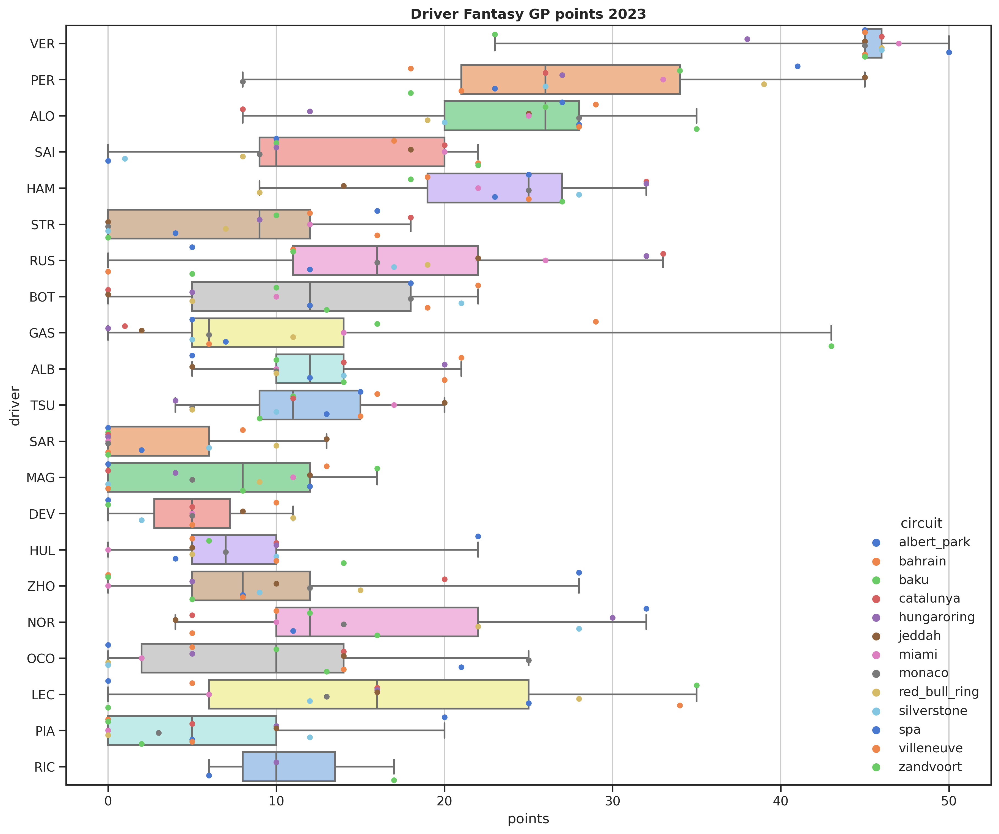

In [ ]:
#| code-fold: true
#| label: fig-driver-points
#| fig-cap: "Fantasy points earned by each driver in 2023"

sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(12, 10))
sns.boxplot(
    data=data_df.reset_index(),
    x="driver_points",
    y="driver",
    palette="pastel",
    whis=[0, 100],
)

sns.stripplot(
    x="driver_points",
    y="driver",
    data=data_df.reset_index(),
    hue="circuit",
    linewidth=0,
    size=5,
    dodge=True,
    palette="muted",
)

ax.xaxis.grid(True)
ax.set(xlabel="points")
ax.set_title("Driver Fantasy GP points 2023");

For convenience, we create a constructor-specific dataframe by taking the first row for each constructor for each race. This gets rid of the duplicate data (as constructor points were duplicated across both drivers):

In [ ]:
const_data_df = data_df.groupby(["circuit", "constructor"]).first().reset_index()

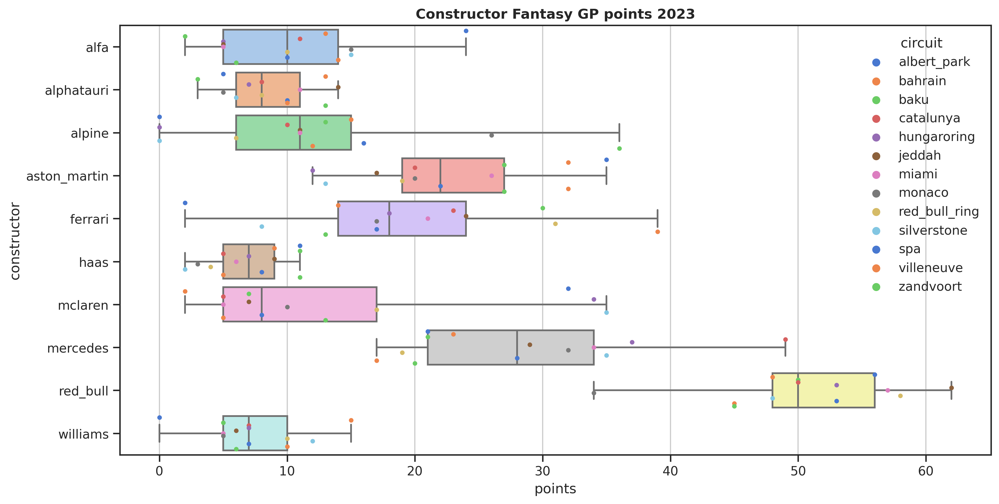

In [ ]:
#| code-fold: true
#| label: fig-constructor-points
#| fig-cap: "Fantasy points earned by each constructor in 2023"

sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(12, 6))
sns.boxplot(
    data=const_data_df.reset_index(),
    x="constructor_points",
    y="constructor",
    palette="pastel",
    whis=[0, 100],
)

sns.stripplot(
    x="constructor_points",
    y="constructor",
    data=const_data_df.reset_index(),
    hue="circuit",
    palette="muted",
    linewidth=0,
    size=4,
    dodge=True,
)

ax.xaxis.grid(True)
ax.set(xlabel="points")
ax.set_title("Constructor Fantasy GP points 2023");

These look quite similar and expose the brutal reality of Red Bull's total dominance over the field. Matching our intuition from the rules definition, drivers appear to earn more and have wider variance in points scored, comapred to teams, with the exception of Max Verstappen and his absurd consistency.

Next, we plot the kernel density estimate of the driver points to gain a better idea of the overall distribution:

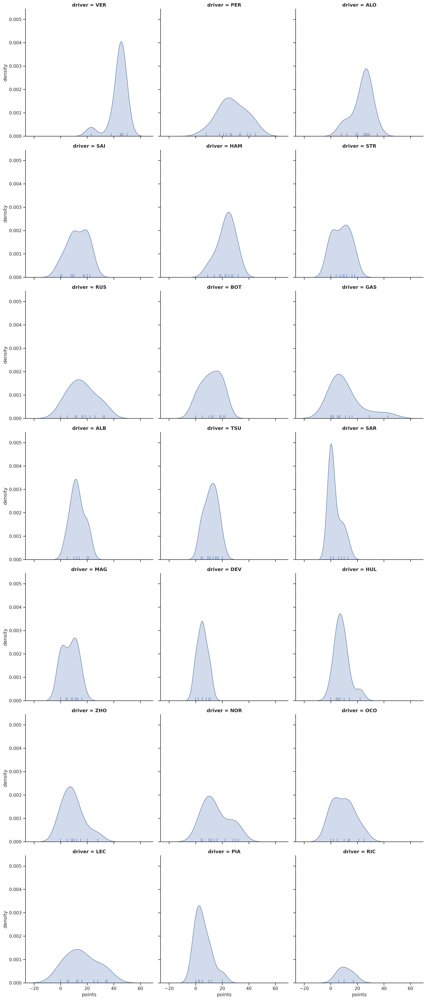

In [ ]:
#| code-fold: true
#| label: fig-driver-points-kde
#| fig-cap: "Kernel density estimates for fantasy points earned by each driver in 2023"
g = sns.displot(
    data_df.reset_index(),
    x="driver_points",
    col="driver",
    kind="kde",
    rug=True,
    col_wrap=3,
    fill=True,
)
g.set_axis_labels("points", "density");

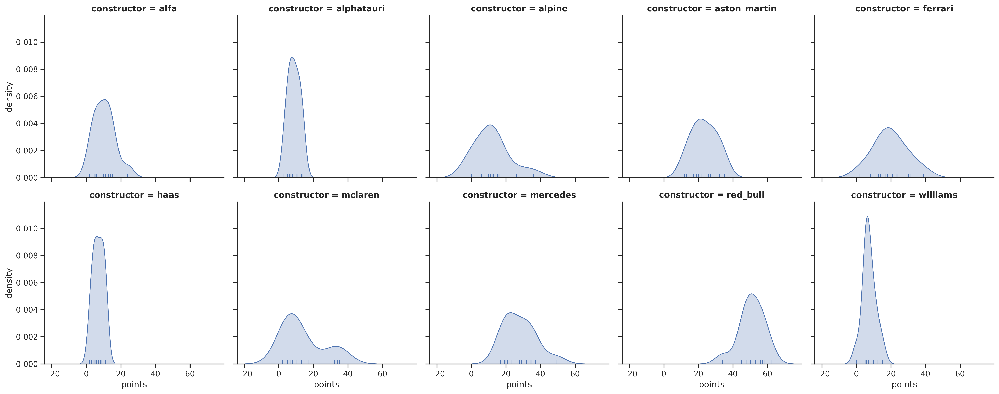

In [ ]:
#| code-fold: true
#| label: fig-constructor-points-kde
#| fig-cap: "Kernel density estimates for fantasy points earned by each constructor in 2023"

g = sns.displot(
    const_data_df.reset_index(),
    x="constructor_points",
    col="constructor",
    col_wrap=5,
    kind="kde",
    height=4,
    rug=True,
    fill=True,
)


g.set_axis_labels("points", "density");

The distribution of points is spread and somewhat multi-peaked in both cases; again, constructors appear score in a much more consistent range compared to drivers. The pooled observed points distributions are:

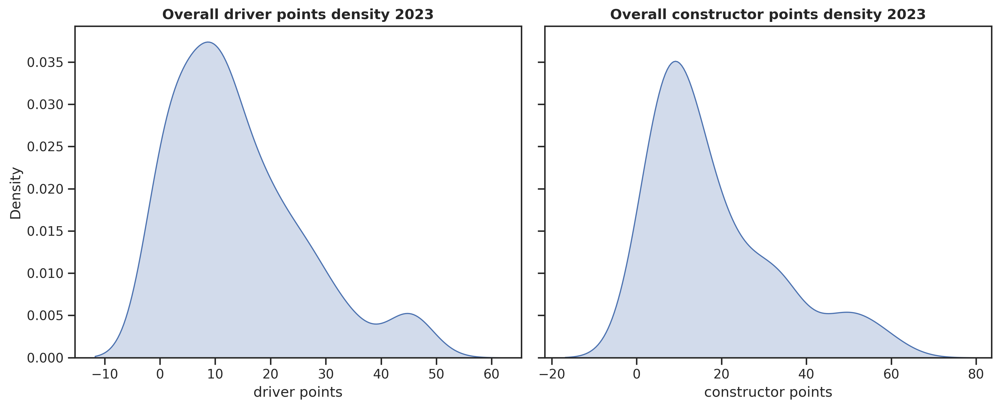

In [ ]:
#| code-fold: true
#| label: fig-grouped-points-kde
#| fig-cap: "Grouped kernel density estimates for fantasy points by drivers/constructors in 2023"

f, axs = plt.subplots(1, 2, figsize=(12, 5), sharey=True)

sns.kdeplot(data_df.reset_index(), x="driver_points", fill=True, ax=axs[0])
sns.kdeplot(const_data_df.reset_index(), x="constructor_points", fill=True, ax=axs[1])
axs[0].set_title("Overall driver points density 2023")
axs[0].set(xlabel="driver points")

axs[1].set_title("Overall constructor points density 2023")
axs[1].set(xlabel="constructor points")

f.tight_layout();

Given that the point distributions between drivers and constructors appear very similar, we'll focus on constructing models of the driver points, which we can later fit to the constructor data with minor adjustments.

## Unpooled model

Our first model will be the simplest possible - we just directly estimate the mean points for each driver individually (an intercept-only, unpooled linear model).

### Picking the likelihood

The points data has several properties that stem from the Fantasy GP ruleset:

- points are discrete
- points are strictly bound between 0 and 84 (25 for p1 + 1 for fastest lap + 10 for pole position + 10 for beating teammate + 19 * 2 for maximum possible positions gained)
- most drivers have a few 0 point finishes, but overall it's very unlikely for a driver to score 0 points consistently.

Because we are modeling discrete, strictly positive points, one of the count distributions is likely an appropriate choice for the likelihood. The [Poisson](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.Poisson.html) distribution could be a good choice, but the observations appear overdispersed, as measured by the [coefficient of dispersion](https://en.wikipedia.org/wiki/Index_of_dispersion):

In [ ]:
#| code-fold: true
data_df = data_df.reset_index().astype(
    {
        "circuit": "category",
        "driver": "category",
    }
)

dispersion = (
    data_df.groupby("driver")["driver_points"].var()
    / data_df.groupby("driver")["driver_points"].mean()
)
dispersion

driver
ALB     2.158586
ALO     2.270430
BOT     4.930283
DEV     2.808279
GAS    13.610345
HAM     1.934783
HUL     3.598765
LEC     8.770227
MAG     4.777778
NOR     6.144891
OCO     7.162602
PER     3.986537
PIA     6.518519
RIC     2.818182
RUS     6.504785
SAI     4.422156
SAR     7.111111
STR     5.604167
TSU     2.145695
VER     1.028269
ZHO     7.261111
Name: driver_points, dtype: float64

Given that, we will pick the [Negative Binomial](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.NegativeBinomial.html) as our likelihood, since it handles overdispersion better^[see the intro to this for more details: https://www.pymc.io/projects/examples/en/latest/generalized_linear_models/GLM-negative-binomial-regression.html].

### Choosing the priors


A [Negative Binomial](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.NegativeBinomial.html) likelihood is defined by two parameters - its mean μ, and a shape parameter α. We'll need to set priors on both.

The mean is restricted to be positive only. The standard way of defining a negative binomial linear model is to set a Normal prior on the mean and use the  exponentiation as the inverse link function to make it positive and usable for parameterizing the likelihood. For the actual prior parameters it would be reasonable to go with a fairly uninformative prior, such as `Normal(mu=0, sigma=1)`; in this case, prior knowledge and the ruleset gives us a hunch that we can reasonably expect most drivers' mean points per race to be somewhere between 5 (backmarker, occasionally beats their teammate, maybe gains a place) and 30 (top driver & team, consistently getting and winning from pole position).

To come up with parameter values for this, we use the [PreliZ](https://preliz.readthedocs.io/en/latest/) library to find a maximum entropy [Normal](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.Normal.html) distribution with 90% of its mass between 5 and 30 (we take the natural log of those, given the exponential inverse link):

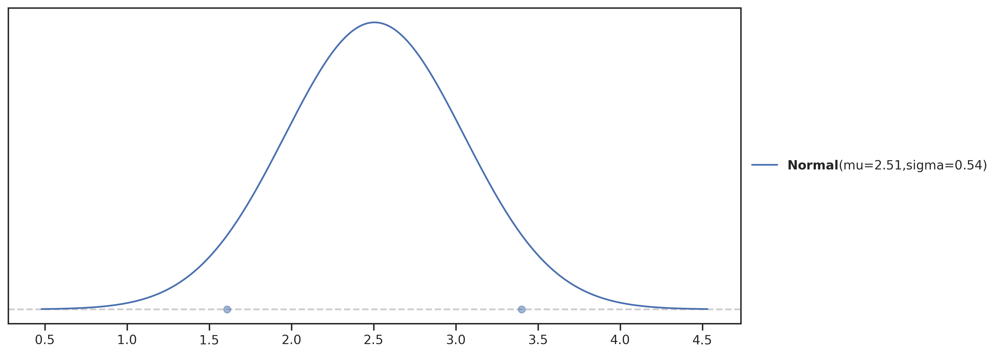

In [ ]:
#| label: fig-mu-prior
#| fig-cap: "PDF of the prior chosen for μ"

mu_dist = pz.Normal()
pz.maxent(mu_dist, np.log(5), np.log(30), 0.90);

The shape parameter α is also strictly positive. Its effect on the likelihood can be best understood by plotting a [Negative Binomial](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.NegativeBinomial.html) for a few different values, while keeping the mean fixed:

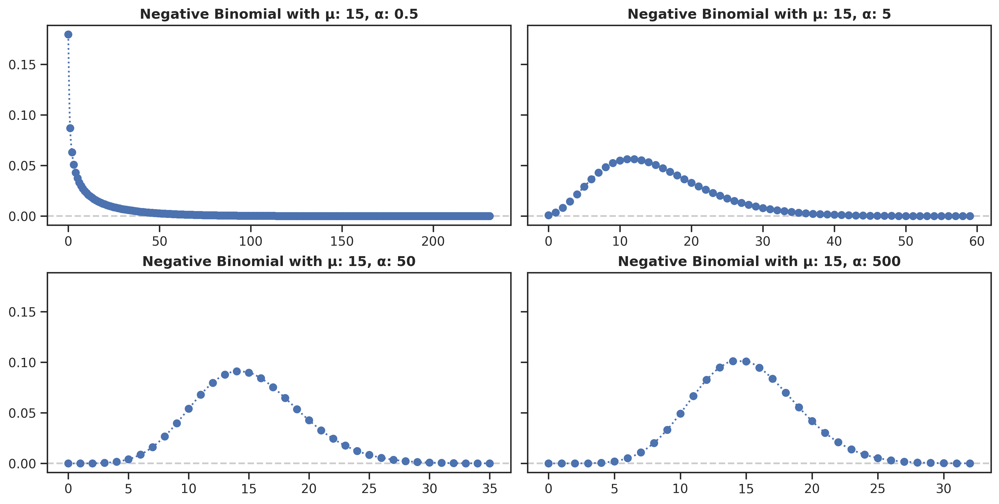

In [ ]:
#| code-fold: true
#| label: fig-nb-shape
#| fig-cap: "Negative binomial distributions with a fixed mean at different shape parameters"

f, axs = plt.subplots(2, 2, figsize=(12, 6), sharey=True)

pz.NegativeBinomial(alpha=0.5, mu=15).plot_pdf(ax=axs[0, 0], legend=False)
axs[0, 0].set_title(f"Negative Binomial with μ: 15, α: 0.5")

pz.NegativeBinomial(alpha=5, mu=15).plot_pdf(ax=axs[0, 1], legend=False)
axs[0, 1].set_title(f"Negative Binomial with μ: 15, α: 5")

pz.NegativeBinomial(alpha=50, mu=15).plot_pdf(ax=axs[1, 0], legend=False)
axs[1, 0].set_title(f"Negative Binomial with μ: 15, α: 50")

pz.NegativeBinomial(alpha=500, mu=15).plot_pdf(ax=axs[1, 1], legend=False)
axs[1, 1].set_title(f"Negative Binomial with μ: 15, α: 500");

As α increases, the tails shrink. We don't want very high values, as that will restrict the tails too much, but very small values result in absurdly long tails. To handle that, we use a [Gamma](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.Gamma.html) distribution, with mass strongly concentrated between 1 and 20:

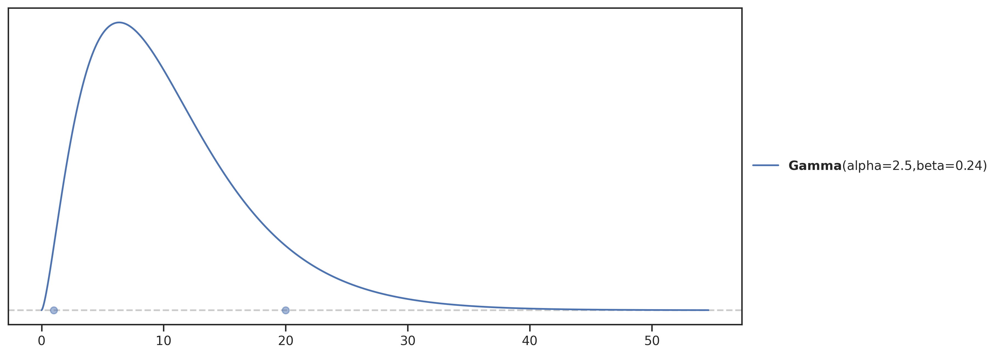

In [ ]:
#| label: fig-alpha-prior
#| fig-cap: "PDF of the prior chosen for α"

alpha_dist = pz.Gamma()
pz.maxent(alpha_dist, 1, 20, .9);

Finally, we prepare the data for use within the model. We factorize the `driver` column into labels and an index:

In [ ]:
idx, labels = pd.factorize(data_df["driver"], sort=True)

`labels` is a categorical variable over the driver names:

In [ ]:
#| echo: false
labels

CategoricalIndex(['ALB', 'ALO', 'BOT', 'DEV', 'GAS', 'HAM', 'HUL', 'LEC',
                  'MAG', 'NOR', 'OCO', 'PER', 'PIA', 'RIC', 'RUS', 'SAI',
                  'SAR', 'STR', 'TSU', 'VER', 'ZHO'],
                 categories=['ALB', 'ALO', 'BOT', 'DEV', ..., 'STR', 'TSU', 'VER', 'ZHO'], ordered=False, dtype='category')

`idx` is the flattened (race number, driver) index into the observed race result rows:

In [ ]:
#| echo: false
idx

array([19, 11,  1, 15,  5, 17, 14,  2,  4,  0, 18, 16,  8,  3,  6, 20,  9,
       10,  7, 12, 11, 19,  1, 14,  5, 15,  7, 10,  4,  8, 18,  6, 20,  3,
       12, 16,  9,  2,  0, 17, 19,  5,  1, 17, 11,  9,  6, 12, 20, 18,  2,
       15,  4, 10,  3, 16,  8, 14,  0,  7, 11, 19,  7,  1, 15,  5, 17, 14,
        9, 18, 12,  0,  8,  4, 10, 16,  6,  2, 20,  3, 19, 11,  1, 14, 15,
        5,  7,  4, 10,  8, 18, 17,  2,  0,  6, 20,  9,  3, 12, 16, 19,  1,
       10,  5, 14,  7,  4, 15,  9, 12,  2,  3, 20,  0, 18, 11,  6, 16,  8,
       17, 19,  5, 14, 11, 15, 17,  1, 10, 20,  4,  7, 18, 12,  3,  6,  0,
        9,  8,  2, 16, 19,  1,  5,  7, 15, 11,  0, 10, 17,  2, 12,  4,  9,
       18,  6, 20,  8,  3, 14, 16, 19,  7, 11,  9,  1, 15, 14,  5, 17,  4,
        0, 20, 16, 10,  2, 12,  3,  8, 18,  6, 19,  9,  5, 12, 14, 11,  1,
        0,  7, 15, 16,  2,  6, 17, 20, 18,  3,  4,  8, 10, 19,  9, 11,  5,
       12, 14,  7, 15,  1, 17,  0,  2, 13,  6, 18, 20,  8, 16, 10,  4, 19,
       11,  7,  5,  1, 14

We also extract the observed points:

In [ ]:
driver_points = data_df["driver_points"]
driver_points

0      45.0
1      18.0
2      29.0
3      17.0
4      19.0
       ... 
255     8.0
256     5.0
257     5.0
258     0.0
259     0.0
Name: driver_points, Length: 260, dtype: float64

### Model definition

Next, we define the model with [PyMC](https://www.pymc.io/). As discussed previously, we think that the process that generates points can be seen as a Negative Binomial distribution, so that is set as the likelihood. The mean (μ) аnd shape (α) are the parameters that we want to infer from the data. Finally, the prior guesses for these parameters are set from the `mu_dist` and `alpha_dist` objects we computed previously.

This translates to:

In [ ]:
with pm.Model(coords={"driver": labels, "idx": idx}) as unpooled_negb:
    μ = pm.Normal("μ", mu_dist.mu, mu_dist.sigma, dims="driver")
    μ_ = pm.Deterministic("μ_", pm.math.exp(μ), dims="driver")

    α = pm.Gamma("α", alpha_dist.alpha, alpha_dist.beta, dims="driver")

    y = pm.NegativeBinomial(
        "y", alpha=α[idx], mu=μ_[idx], observed=driver_points, dims="idx"
    )

### Prior predictive checks

To see if the choice for priors is acceptable, we sample from the prior predictive and plot the results:

In [ ]:
with unpooled_negb:
    unpooled_prior_samples = pm.sample_prior_predictive(samples=1000)

Sampling: [y, α, μ]


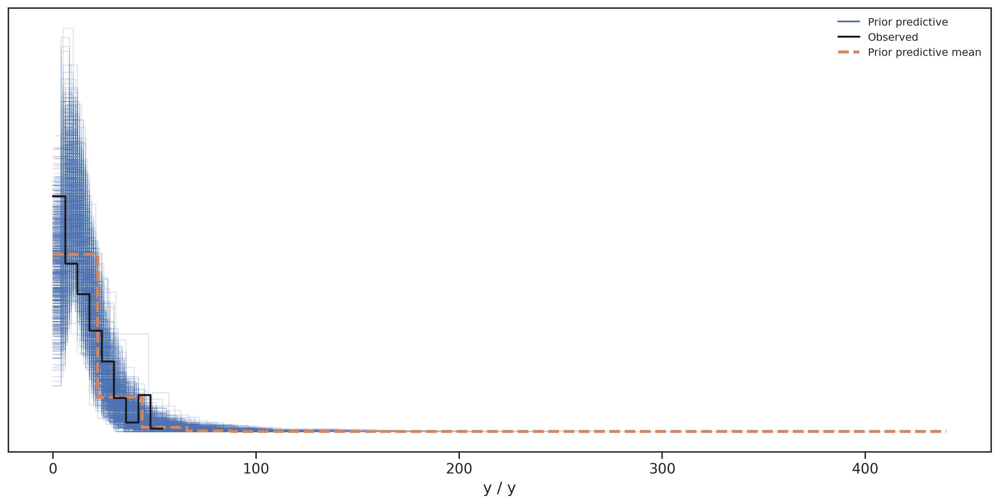

In [ ]:
#| label: fig-unpooled-prior-predictive
#| fig-cap: "Prior predictive distribution of the unpooled model"

az.plot_ppc(unpooled_prior_samples, group="prior", figsize=(12, 6));

The prior predictive is quite wide, with a very long and somewhat fat tail, but overall the data could be plausibly seen as coming from it.

### Inference and diagnostics


Next, we perform the actual inference step - we sample from the posterior and the posterior predictive distribution:

In [ ]:
with unpooled_negb:
    unpooled_idata = pm.sample(target_accept=0.9, idata_kwargs={"log_likelihood": True})
    pm.sample_posterior_predictive(unpooled_idata, extend_inferencedata=True)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [μ, α]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 4 seconds.
Sampling: [y]


There are no divergences detected, which is a good first sign that the model has converged.

To check the sampling process we plot the traces for the μ parameter. What we are looking for is similar densities on the left (indicating that the chains have converged to the same posterior distribution), and noisy/patternless trace plots on the right (which would indicate that the sampler was able to efficiently run through the sample space)^[see this for a quick summary of model checking techniques: https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/pymc_overview.html#model-checking]:

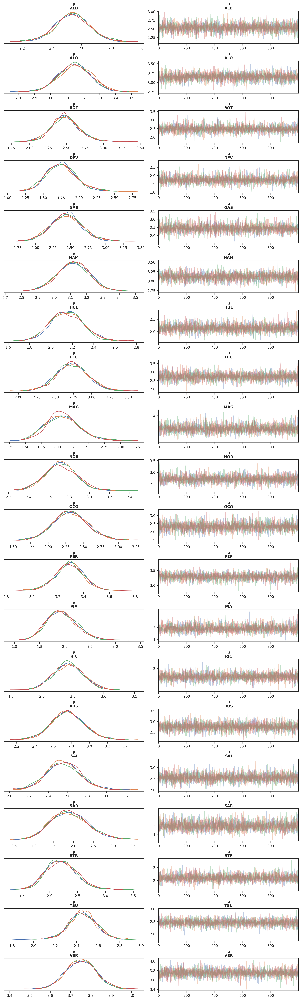

In [ ]:
#| label: fig-unpooled-traceplots
#| fig-cap: "Traceplots of the inferred parameter μ for the unpooled model"

az.plot_trace(unpooled_idata, var_names=["μ"], compact=False);

There are a few kinks here and there (see RIC), but overall these look good.

Next we plot the [energy plot](https://python.arviz.org/en/latest/api/generated/arviz.plot_energy.html#r74895e2d4323-1) and [BFMI](https://python.arviz.org/en/latest/api/generated/arviz.bfmi.html#arviz.bfmi). Ideally the marginal energy and energy transition distributions should overlap as much as possible, and BFMI should be to be above .3:

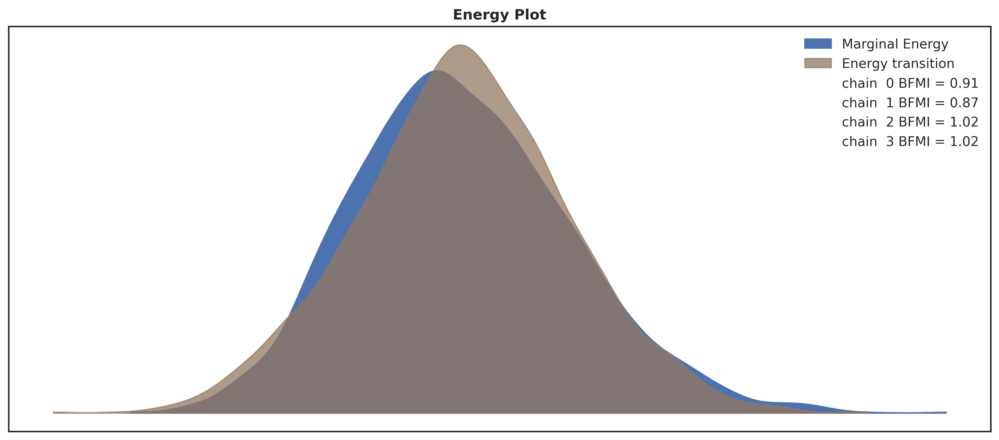

In [ ]:
#| code-fold: true
#| label: fig-unpooled-energy
#| fig-cap: "Energy plot for the unpooled model"

ax = az.plot_energy(unpooled_idata)
ax.set_title("Energy Plot");

Finally, we check the summary statistics for the μ parameter:

- bulk and tail effective sample size (`ess_bulk` and `ess_tail` respectively) should be > 400, otherwise the estimation of the rest of the summary statistics is considered unreliable ^[see: https://bayesiancomputationbook.com/markdown/chp_02.html#effective-sample-size]
- `r_hat` should ideally equal 1, with values over 1.01 convergence issues ^[see: https://bayesiancomputationbook.com/markdown/chp_02.html#potential-scale-reduction-factor-hat-r]
- `mcse_{mean, sd}` is the Monte Carlo Standard Error, or the error introduced by approximating the posterior with a finite number of samples; lower = better ^[see: https://bayesiancomputationbook.com/markdown/chp_02.html#monte-carlo-standard-error]

In [ ]:
az.summary(unpooled_idata, var_names=["μ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
μ[ALB],2.540,0.117,2.315,2.766,0.002,0.001,4820.0,2814.0,1.0
μ[ALO],3.150,0.100,2.964,3.336,0.002,0.001,4437.0,2644.0,1.0
μ[BOT],2.484,0.195,2.142,2.877,0.003,0.002,4326.0,2388.0,1.0
μ[DEV],1.756,0.216,1.384,2.210,0.004,0.003,3618.0,2383.0,1.0
μ[GAS],2.444,0.231,1.977,2.848,0.003,0.002,5514.0,2962.0,1.0
μ[HAM],3.118,0.099,2.927,3.299,0.002,0.001,4304.0,2729.0,1.0
μ[HUL],2.149,0.155,1.866,2.439,0.002,0.002,4272.0,2824.0,1.0
μ[LEC],2.736,0.216,2.324,3.138,0.003,0.002,4111.0,2447.0,1.0
μ[MAG],2.090,0.270,1.603,2.614,0.004,0.003,3817.0,2615.0,1.0
μ[NOR],2.716,0.156,2.420,2.999,0.002,0.002,4364.0,2633.0,1.0


All of the sampling diagnistics look good, which means the model has converged and we can move on to posterior predictive checks and model evaluation.

### Posterior predictive checks

Next we examine the posterior predictive distribution, which will help validate that the predictions the model is making make sense given the data. Below we plot several posterior graphs (from top to bottom, left to right):

- the (grouped) posterior predictive distribution should closely replicate the pattern seen in the observed data ^[see: https://bayesiancomputationbook.com/markdown/chp_02.html#understanding-your-predictions]
- the Bayesian p-value is the probability of the predicted data being equal to or less than the observed data. The ideal/expected outcome is represented by the dashed line (0.5), with the solid line being the KDE of the predicted data; the u-value represents the same idea as the p-value, but per observation - it should be roughly uniform ^[see: https://bayesiancomputationbook.com/markdown/chp_02.html#fig-posterior-predictive-check-pu-values]
- LOO-PIT is the probability integral transform checed with LOO-CV; this should be close to uniform; difference between LOO-PIT empirical cumulative distribution function and the uniform cdf ^[see: https://oriolabrilpla.cat/en/blog/posts/2019/loo-pit-tutorial.html]

In [ ]:
#| code-fold: true

def plot_posterior_predictive_checks(idata):
    f = plt.figure(figsize=(12, 12))

    ax_ppc = f.add_subplot(3, 1, 1)
    az.plot_ppc(idata, ax=ax_ppc)
    ax_ppc.set_title("Posterior predictive checks")

    ax_bpv = f.add_subplot(3, 2, 3)
    az.plot_bpv(idata, kind="p_value", ax=ax_bpv)
    ax_bpv.set_title("Bayesian p_value")

    ax_uv = f.add_subplot(3, 2, 4)
    az.plot_bpv(idata, kind="u_value", ax=ax_uv)
    ax_uv.set_title("Marginal p_value")

    ax_loo_pit_ecdf = f.add_subplot(3, 2, 5)
    az.plot_loo_pit(idata, y="y", ecdf=True, ax=ax_loo_pit_ecdf)
    ax_loo_pit_ecdf.set_title("LOO-PIT (ecdf=True)")

    ax_loo_pit = f.add_subplot(3, 2, 6)
    az.plot_loo_pit(idata, y="y", ecdf=False, ax=ax_loo_pit)
    ax_loo_pit.set_title("LOO-PIT (ecdf=False)")

    f.tight_layout()

    return (ax_ppc, ax_bpv, ax_uv, ax_loo_pit_ecdf, ax_loo_pit)

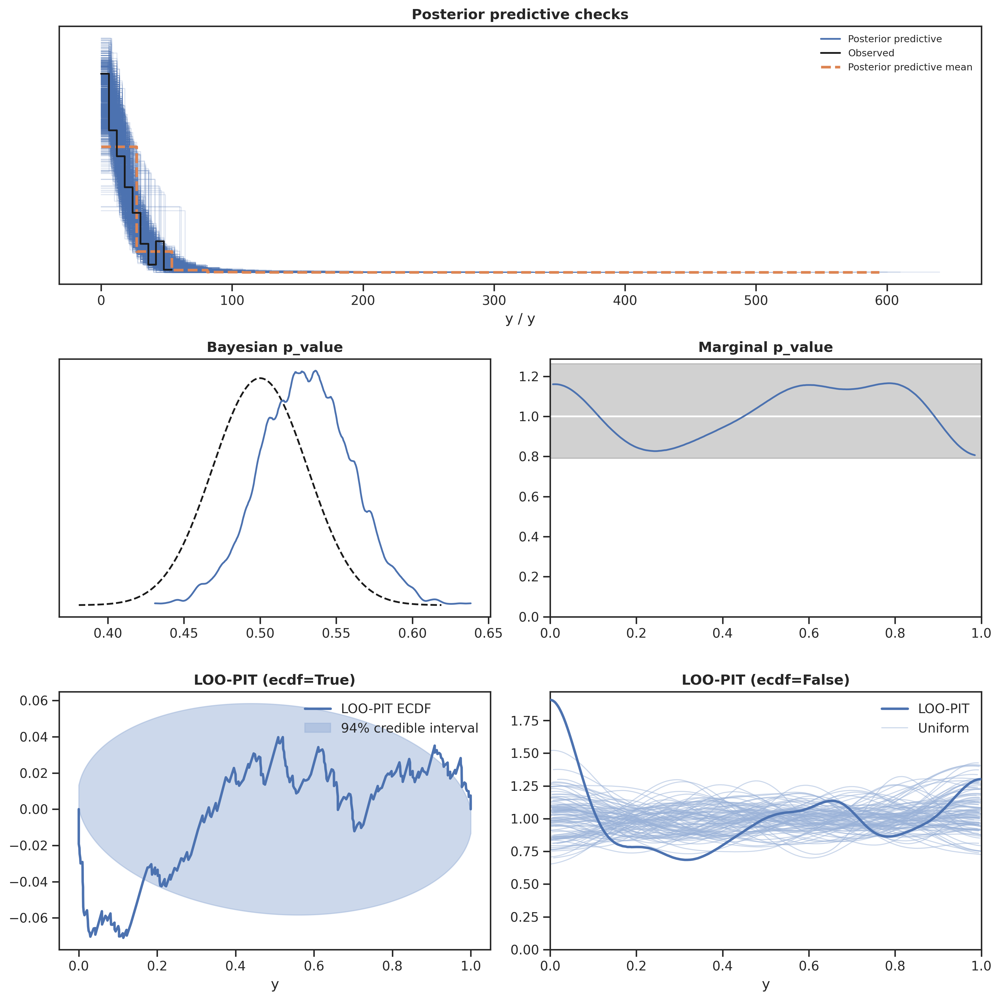

In [ ]:
#| label: fig-unpooled-ppc
#| fig-cap: "Posterior predictive checks, u/p-value, and LOO for the unpooled model"

plot_posterior_predictive_checks(unpooled_idata);

From the posterior predictive plots it seems that:

- the posterior predictive samples roughly look like tha observed data, but the fit around the right tail isn't the best.
- the p-value plot shows that the model's predictions are somewhat shifted to the right and the u-value plot indicates that the model is missing observations in the left tail ^[for a detailed guide on interpreting the bpv plots see: https://bayesiancomputationbook.com/markdown/chp_02.html#fig-posterior-predictive-many-examples]
- LOO-PIT shows the model is likely biased, which agrees with the p/u-value plots.

Lastly, let's plot the posterior predictive distributions for a few individual drivers:

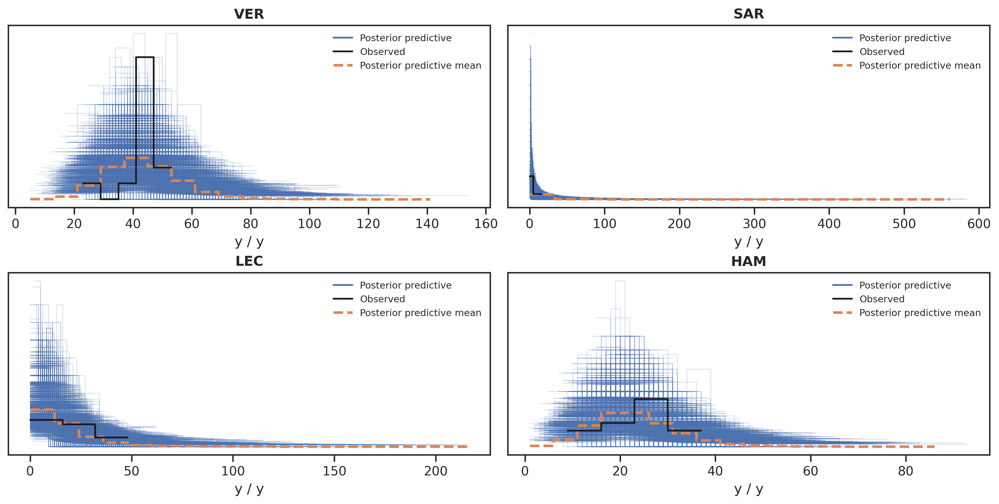

In [ ]:
#| code-fold: true
#| label: fig-unpooled-ppc-individual
#| fig-cap: "Posterior predictive plots of individual drivers for the unpooled model"

fig, axs = plt.subplots(2, 2, figsize=(12, 6))

DriverIdx = Enum("Driver", zip(labels.categories, labels.codes))

az.plot_ppc(unpooled_idata, coords={"idx": [DriverIdx.VER.value]}, ax=axs[0, 0])
axs[0, 0].set_title("VER")

az.plot_ppc(unpooled_idata, coords={"idx": [DriverIdx.SAR.value]}, ax=axs[0, 1])
axs[0, 1].set_title("SAR")

az.plot_ppc(unpooled_idata, coords={"idx": [DriverIdx.LEC.value]}, ax=axs[1, 0])
axs[1, 0].set_title("LEC")

az.plot_ppc(unpooled_idata, coords={"idx": [DriverIdx.HAM.value]}, ax=axs[1, 1])
axs[1, 1].set_title("HAM");

### Posterior evaluation

We are reasonably confident that the model has converged and that there were no issues during sampling. Predictions seem to be somewhat biased, but still reasonable for our purposes. Now it's time to check the posterior distributions of the estimated parameter μ:

In [ ]:
#| label: fig-unpooled-posterior-mean
#| fig-cap: "Posterior distributions of the μ parameter for the unpooled model"

az.plot_posterior(unpooled_idata, var_names=["μ"]);

The estimates look well formed; to make comparing the parameter value between drivers easier, we plot a forest of the 94% HDI ^[see: https://sjster.github.io/introduction_to_computational_statistics/docs/Production/PyMC3.html#hdi]:

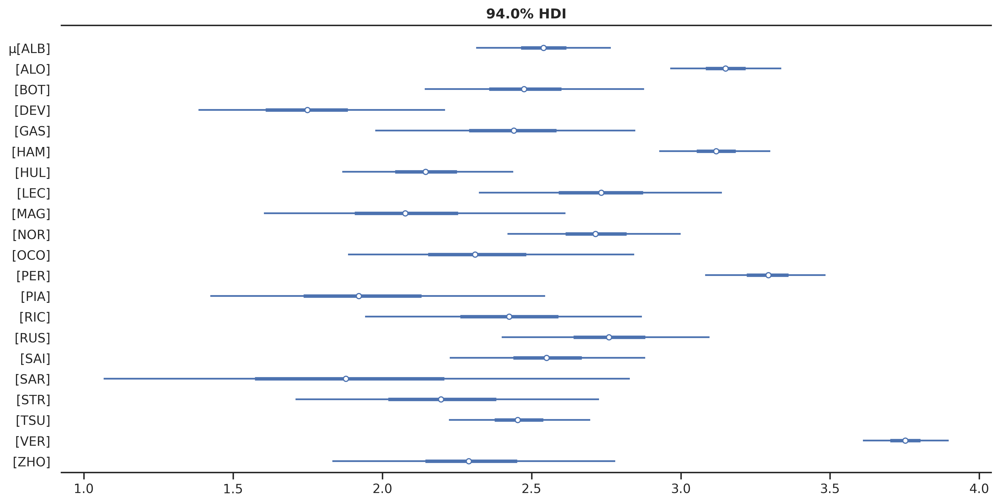

In [ ]:
#| label: fig-unpooled-posterior-forest-log
#| fig-cap: "Forest of the posterior distributions of μ for the unpooled model (log scale)"

az.plot_forest(unpooled_idata, var_names=["μ"], combined=True, figsize=(12, 6));

The probability distributions for the means broadly agree with our informal observations throughout the season - VER is scoring high above the rest, in an extremely consistent range, with HAM, ALO, and PER close to eachother for second place, a mixed, variable set of results for the midfield, and a few clear backmarker drivers.

To translate the estimated parameter values to points, we can plot the transformed μ_ value (remember that this is just the exponentiated μ):

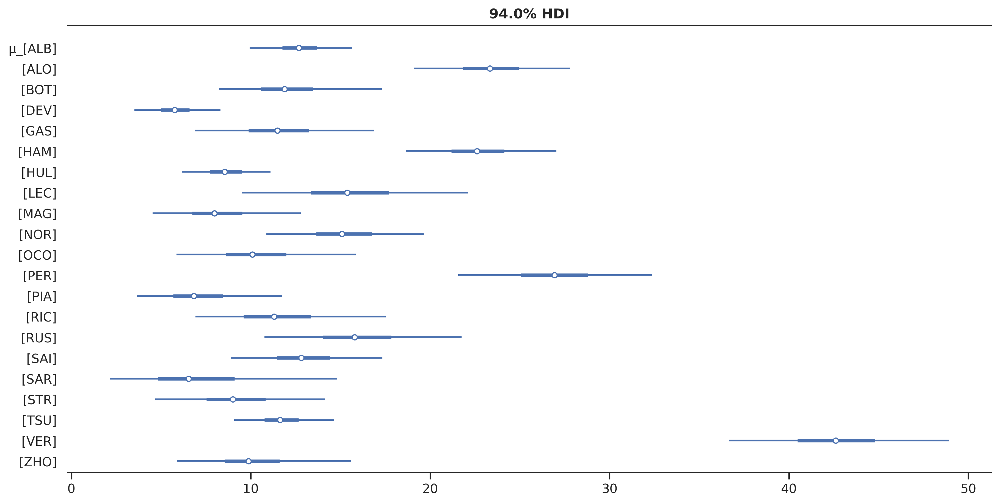

In [ ]:
#| label: fig-unpooled-posterior-forest
#| fig-cap: "Forest of the posterior distributions of μ for the unpooled model"

az.plot_forest(unpooled_idata, var_names=["μ_"], combined=True, figsize=(12, 6));

### Model evaluation

Finally, we inspect [PSIS-LOO-CV](https://python.arviz.org/en/stable/api/generated/arviz.loo.html) to get an idea of the performance of the model:

In [ ]:
az.loo(unpooled_idata)

Computed from 4000 posterior samples and 260 observations log-likelihood matrix.

         Estimate       SE
elpd_loo  -890.07    14.57
p_loo       44.35        -

There has been a warning during the calculation. Please check the results.
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)      251   96.5%
 (0.5, 0.7]   (ok)          8    3.1%
   (0.7, 1]   (bad)         1    0.4%
   (1, Inf)   (very bad)    0    0.0%

`elpd_loo` ^[see: https://bayesiancomputationbook.com/markdown/chp_02.html#cross-validation-and-loo] will be more useful when comparing this baseline model to other, more complicated ones, but the fact that Pareto k values are all significantly below 0.7 is a good sign that the model can generalize decently.

## Zero-inflated unpooled model

One of the common issues with both [Poisson](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.Poisson.html#pymc.Poisson) and [Negative Binomial](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.NegativeBinomial.html#pymc.NegativeBinomial) models is that they do not generate zeroes often enough. This can be alleviated by using a mixture model that inflates the number of zeroes, which `PyMC` already has an implementation of - the [Zero Inflated Negative Binomial likelihood](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.ZeroInflatedNegativeBinomial.html).

To test that extra zeroes might result in a better fit, we define a new model with the same priors as before, but using the mixture likelihood. One additional parameter, ψ, is needed, so we have to set a prior over that. ψ is the probability of a non-zero value, between 0 and 1. We will use a [Beta](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.Beta.html) as the prior distribution, and given the ruleset and reliability of modern F1 cars, our prior belief is that 0 point finishes aren't all that likely. To express that, we take the maximum entropy Beta whose mass is concentrated between .8 and .99:

### Choosing priors

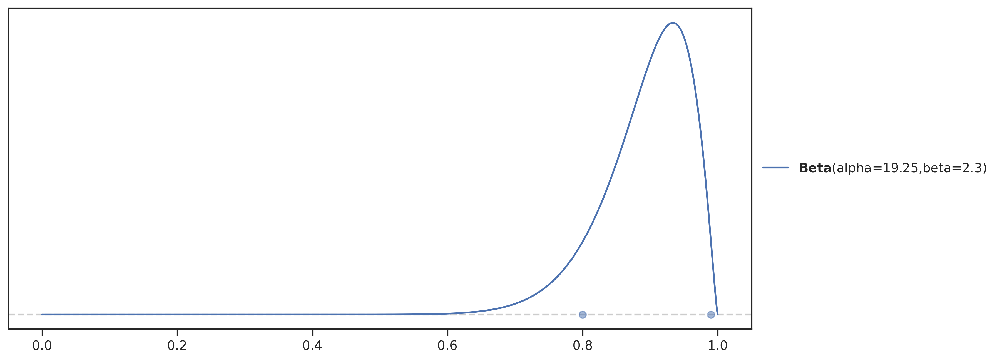

In [ ]:
#| label: fig-zi-psi-prior
#| fig-cap: "Prior distribution for the ψ parameter (probability of a non-zero value)"

psi_dist = pz.Beta()
pz.maxent(psi_dist, 0.8, 0.99, 0.9);

### Model definition

The new model is trivial to define:

In [ ]:
with pm.Model(coords={"driver": labels, "idx": idx}) as zi_unpooled_negb:
    μ = pm.Normal("μ", mu_dist.mu, mu_dist.sigma, dims="driver")
    μ_ = pm.Deterministic("μ_", pm.math.exp(μ), dims="driver")

    α = pm.Gamma("α", alpha_dist.alpha, alpha_dist.beta, dims="driver")

    ψ = pm.Beta("ψ", psi_dist.alpha, psi_dist.beta, dims="driver")

    y = pm.ZeroInflatedNegativeBinomial(
        "y",
        psi=ψ[idx],
        alpha=α[idx],
        mu=μ_[idx],
        observed=driver_points,
        dims="idx",
    )

### Prior evaluation

We perform the same prior predictive check:

In [ ]:
with zi_unpooled_negb:
    zi_unpooled_prior_samples = pm.sample_prior_predictive(samples=1000)

Sampling: [y, α, μ, ψ]


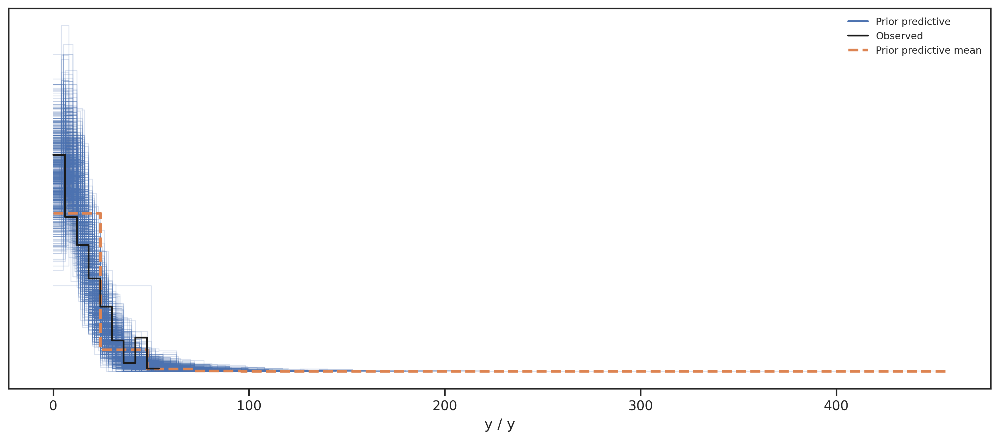

In [ ]:
#| label: fig-zi-prior-predictive
#| fig-cap: "Prior predictive distribution for the zero-inflated model"

az.plot_ppc(zi_unpooled_prior_samples, group="prior");

### Inference and diagnostics

Sample:

In [ ]:
with zi_unpooled_negb:
    zi_unpooled_idata = pm.sample(
        target_accept=0.9, idata_kwargs={"log_likelihood": True}
    )
    pm.sample_posterior_predictive(zi_unpooled_idata, extend_inferencedata=True)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [μ, α, ψ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 7 seconds.
Sampling: [y]


The traceplots look about as good as before:

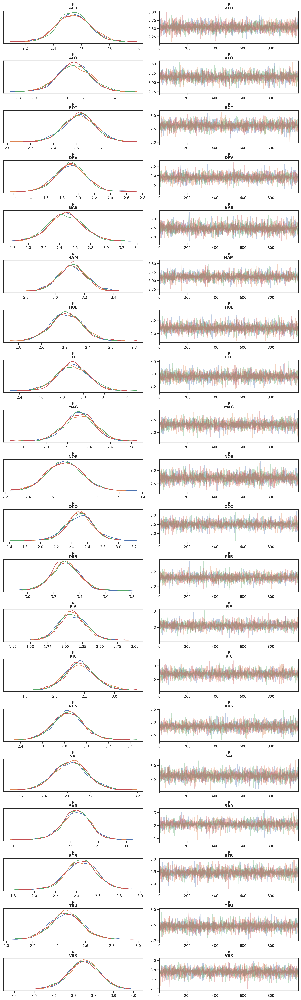

In [ ]:
#| label: fig-zi-traceplots
#| fig-cap: "Traceplots of the μ parameter for the zero-inflated model"

az.plot_trace(zi_unpooled_idata, var_names=["μ"], compact=False);

BFMI and energy are reasonable:

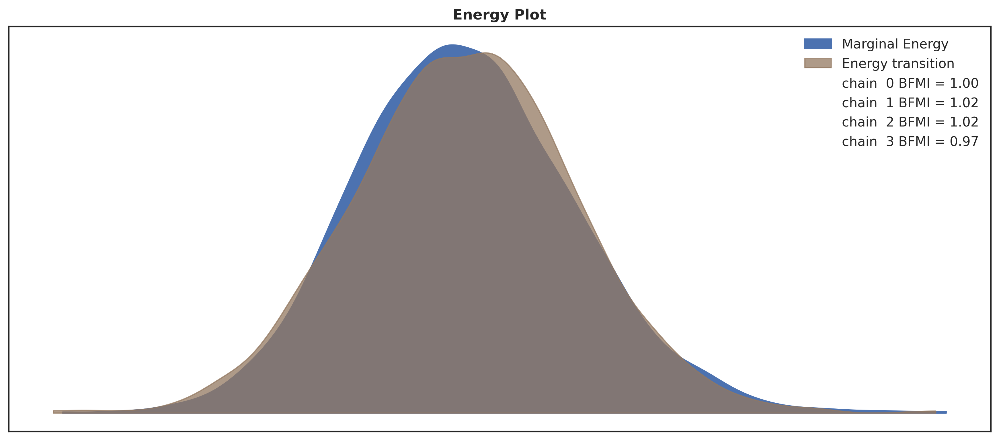

In [ ]:
#| code-fold: true
#| label: fig-zi-energy
#| fig-cap: "Energy plot for the zero-inflated model"

ax = az.plot_energy(zi_unpooled_idata)
ax.set_title("Energy Plot");

`r_hat` and ESS look good as well:

In [ ]:
az.summary(zi_unpooled_idata, var_names=["μ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
μ[ALB],2.543,0.117,2.313,2.755,0.001,0.001,6935.0,2916.0,1.0
μ[ALO],3.150,0.103,2.964,3.352,0.001,0.001,6889.0,2785.0,1.0
μ[BOT],2.628,0.136,2.367,2.882,0.002,0.001,7210.0,3036.0,1.0
μ[DEV],1.907,0.187,1.552,2.247,0.002,0.002,6303.0,2947.0,1.0
μ[GAS],2.488,0.223,2.061,2.903,0.003,0.002,6542.0,2615.0,1.0
μ[HAM],3.116,0.098,2.919,3.288,0.001,0.001,7676.0,2780.0,1.0
μ[HUL],2.215,0.142,1.950,2.485,0.002,0.001,7132.0,2852.0,1.0
μ[LEC],2.902,0.150,2.616,3.186,0.002,0.001,6608.0,2743.0,1.0
μ[MAG],2.310,0.144,2.043,2.574,0.002,0.001,6878.0,2735.0,1.0
μ[NOR],2.720,0.152,2.437,3.014,0.002,0.001,7287.0,2621.0,1.0


### Posterior predictive checks

Posterior predictive checks look somewhat better:

- the posterior predictive fits about as well, with a slightly thinner tail
- p-value is still shifted
- u-value is much closer to uniform
- LOO-PIT still suggests bias, but it looks slightly better overall; the right tail of the posterior predictive still looks too fat and goes well above the maximum points possible in the ruleset, likely causing the bias and shifted predictions.

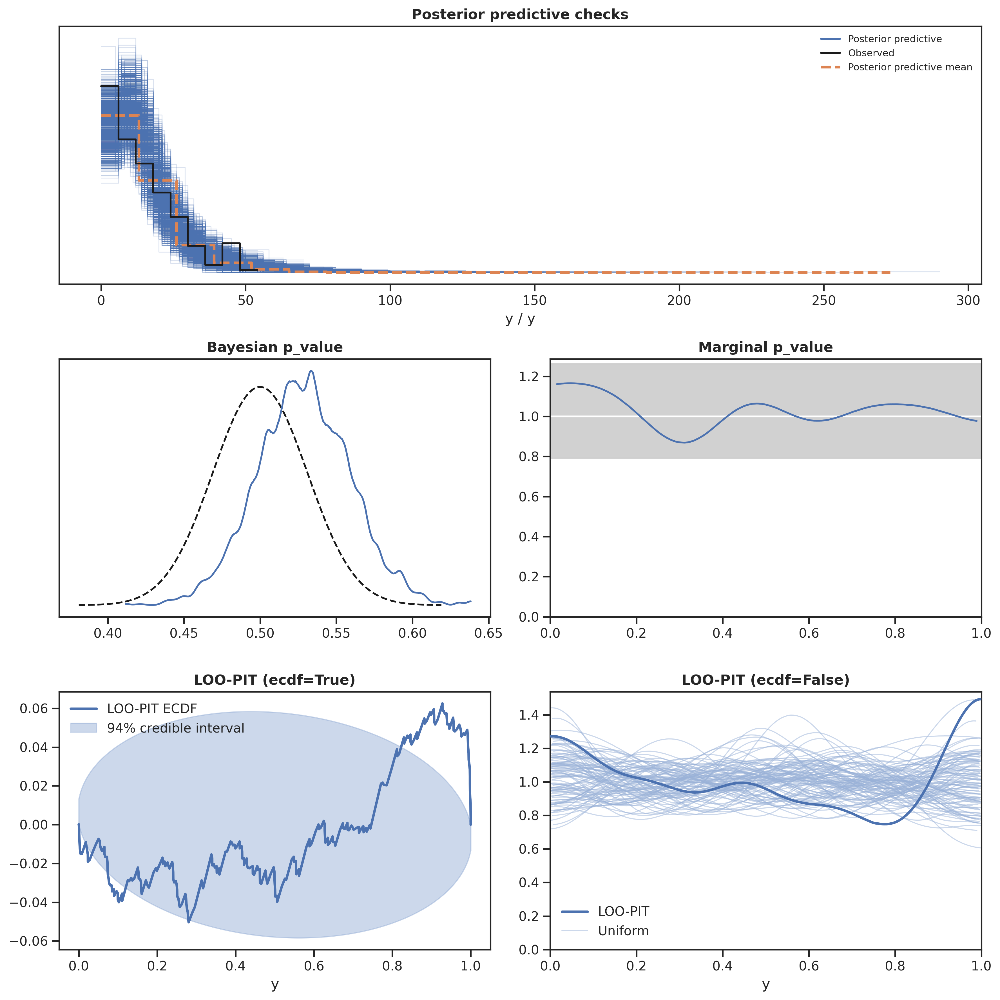

In [ ]:
#| label: fig-zi-ppc
#| fig-cap: "Posterior predictive checks, p/u-value, and LOO for the zero-inflated model"

plot_posterior_predictive_checks(zi_unpooled_idata);

### Posterior evaluation

We plot just the forest of transformed means:

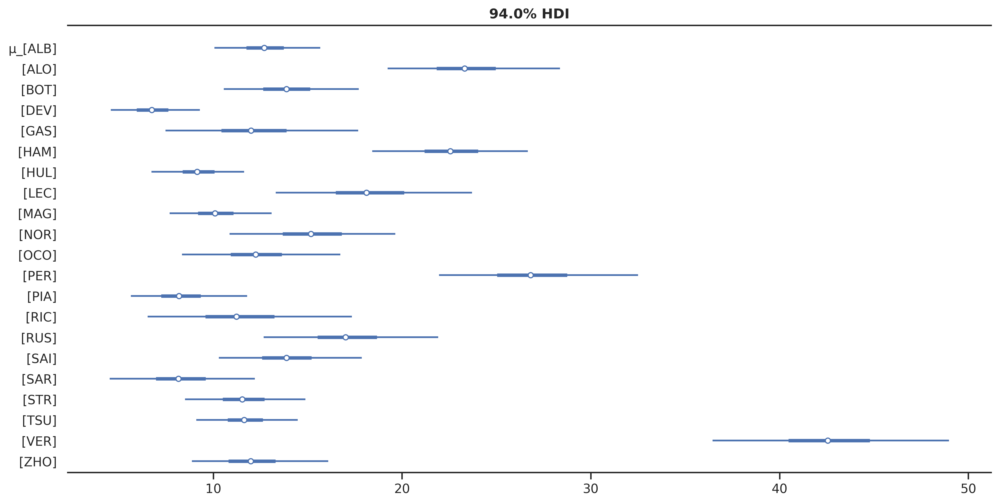

In [ ]:
#| label: fig-zi-mu-forest
#| fig-cap: "Forest plot of the posterior distribution of the exponentiated μ parameter for the zero-inflated model"

az.plot_forest(zi_unpooled_idata, var_names=["μ_"], combined=True, figsize=(12, 6));

As expected, compared to the basic model, the means have been pulled towards zero slightly and the HDIs have shrunk.

### Model comparison

Now that we have two models it's worth running a comparison to see which performs better ^[see: https://bayesiancomputationbook.com/markdown/chp_02.html#model-comparison]:

In [ ]:
#| code-fold: true
comparison = az.compare(
    {"unpooled": unpooled_idata, "zero inflated unpooled": zi_unpooled_idata}
)
comparison

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
zero inflated unpooled,0,-857.315342,37.602844,0.000000,0.860751,15.433125,0.00000,True,log
unpooled,1,-890.073682,44.352860,32.758341,0.139249,14.570539,10.71031,True,log


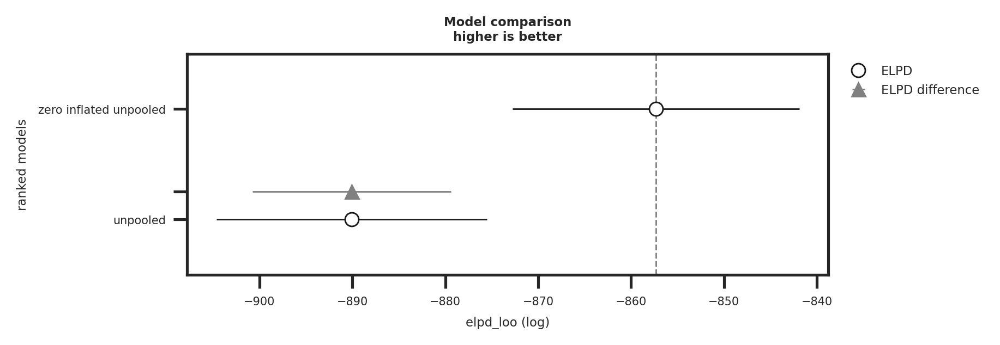

In [ ]:
#| label: fig-zi-comparison
#| fig-cap: "Comparison of the performance of the unpooled and zero-inflated models"

az.plot_compare(comparison);

The zero-inflated model clearly seems to perform better ^[for much more information on cross validation see: https://avehtari.github.io/modelselection/CV-FAQ.html#12_What_is_the_interpretation_of_ELPD__elpd_loo__elpd_diff].

## Driver estimates

We have a reasonable looking, if a bit biased model for driver points, which we'll now use to inform fantasy team construction.

When picking drivers, we consider the following:

- how many points per race is the driver expected to bring and how reliably
- how likely  is it that a given driver will outperform another driver, and by what magnitude
- how underpriced/overpriced is a a driver given their performance

While price analysis is out of the scope of this notebook, the points estimation model can help us with the first two questions.

Below, we compare each driver to their rivals, using the difference of predicted points per race. To do so, we take the predictions generated from the posterior predictive distribution for each driver, subtract the two vectors, and take the mean. This reduces the posterior distributions to a point estimate, but still incorporates the uncertainty of the model, as we work directly with values generated from the posterior. The value can be seen both as confidence driver x is better than driver y - higher is better, and as the points we expect driver x to earn over driver y on average.


::: {.callout-caution}
The plot below isn't symmetric over the right diagonal - we are strictly comparing the driver on the X axis to the driver on the Y axis.
:::


In [ ]:
def make_comparison(idata, idx, groups, size=1000):
    columns = {}
    for idx_a, name_a in enumerate(groups):
        for idx_b, name_b in enumerate(groups):
            pp_a = idata.posterior_predictive["y"][:, :, idx == idx_a].values.flatten()
            pp_b = idata.posterior_predictive["y"][:, :, idx == idx_b].values.flatten()

            samples_a = np.random.choice(pp_a, size=size)
            samples_b = np.random.choice(pp_b, size=size)

            if idx_a != idx_b:
                points_over = (samples_a - samples_b).mean()
            else:
                points_over = 0

            columns.setdefault(name_a, []).append(points_over)

    comparison_df = pd.DataFrame.from_dict(columns).set_index(groups)
    mask = np.triu(np.ones_like(comparison_df, dtype=bool))

    return comparison_df, mask

In [ ]:
comparison_df, mask = make_comparison(zi_unpooled_idata, idx, labels)

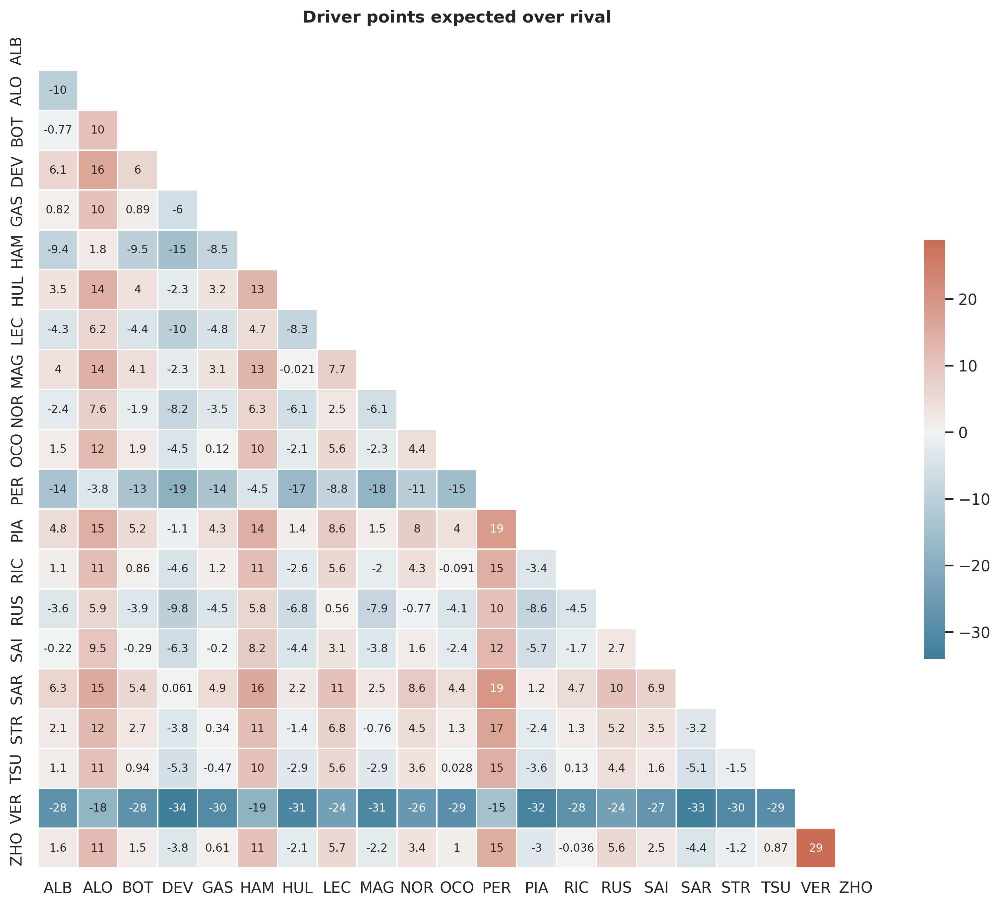

In [ ]:
#| code-fold: true
#| label: fig-drivers-comparison
#| fig-cap: "Expected points earned by driver x over driver y using the zero-inflated model"

sns.set_theme(style="white")

cmap = sns.diverging_palette(230, 20, as_cmap=True)

f, ax = plt.subplots(figsize=(11, 9))

ax = sns.heatmap(
    comparison_df,
    cmap=cmap,
    mask=mask,
    annot=True,
    center=0,
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
    annot_kws={"fontsize": 8},
).set(title="Driver points expected over rival");

## Constructor estimates

We'll run the same loop for the constructor comparison - first we define a slightly modified zero inflated model, then we sample, validate convergence, and finally use the posterior and posterior predictive to evaluate constructor peformance.

Data preparation is identical - we factorize the constructors and take the points

In [ ]:
const_idx, const_labels = pd.factorize(const_data_df["constructor"], sort=True)
const_points = const_data_df["constructor_points"]

We adjust the priors slightly, to account for differences in the constructors scoring system:

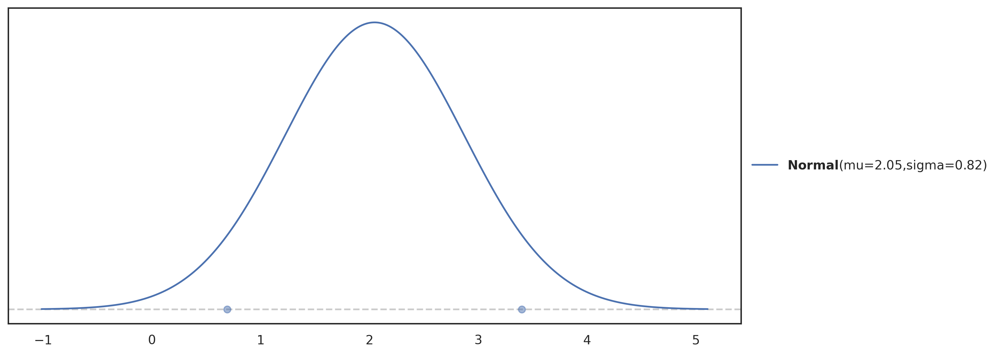

In [ ]:
#| label: fig-constructors-mu-prior
#| fig-cap: "Prior for the μ parameter for fitting the zero inflated model to the constructor data"

mu_const_dist = pz.Normal()
pz.maxent(mu_const_dist, np.log(2), np.log(30), 0.9);

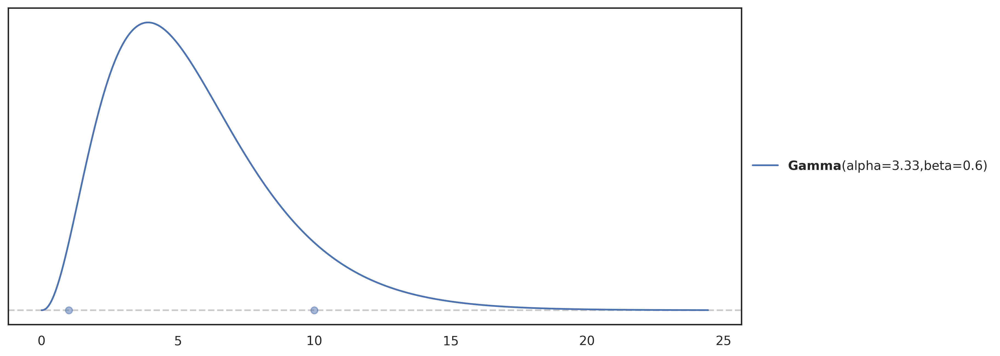

In [ ]:
#| label: fig-constructors-alpha-prior
#| fig-cap: "Prior for the α parameter for fitting the zero inflated model to the constructor data"

alpha_const_dist = pz.Gamma()
pz.maxent(alpha_const_dist, 1, 10, .9);

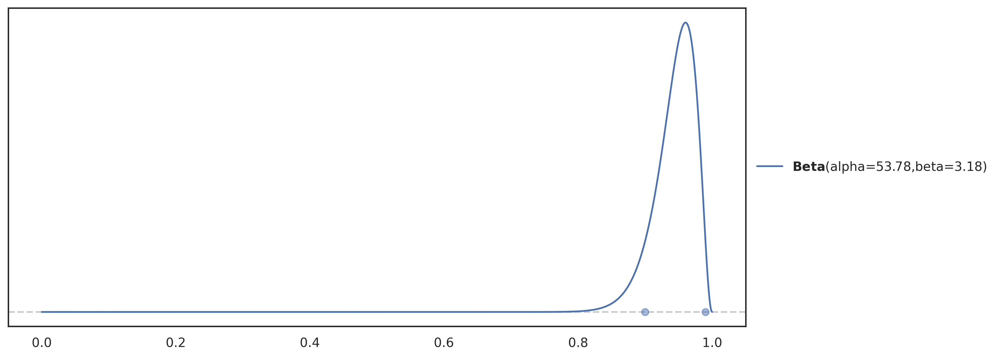

In [ ]:
#| label: fig-constructors-psi-prior
#| fig-cap: "Prior for the ψ parameter for fitting the zero inflated model to the constructor data"

psi_const_dist = pz.Beta()
pz.maxent(psi_const_dist, .9, .99, .9);

In [ ]:
with pm.Model(
    coords={"constructor": const_labels, "idx": const_idx}
) as const_zi_unpooled_model:
    μ = pm.Normal("μ", mu_const_dist.mu, mu_const_dist.sigma, dims="constructor")
    μ_ = pm.Deterministic("μ_", pm.math.exp(μ), dims="constructor")

    α = pm.Gamma("α", alpha_const_dist.alpha, alpha_const_dist.beta, dims="constructor")

    ψ = pm.Beta("ψ", psi_const_dist.alpha, psi_const_dist.beta, dims="constructor")

    y = pm.ZeroInflatedNegativeBinomial(
        "y",
        psi=ψ[const_idx],
        alpha=α[const_idx],
        mu=μ_[const_idx],
        observed=const_points,
        dims="idx",
    )

In [ ]:
with const_zi_unpooled_model:
    const_prior_pred = pm.sample_prior_predictive(samples=1000)

Sampling: [y, α, μ, ψ]


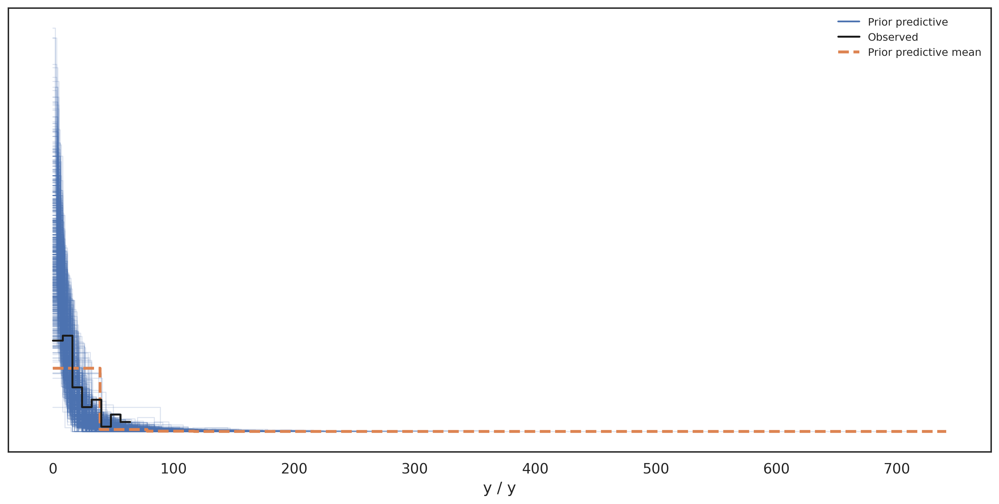

In [ ]:
#| label: fig-constructors-prior-predictive
#| fig-cap: "Prior predictive distribution for the zero-inflated model when fitted to the constructors data"

az.plot_ppc(const_prior_pred, group="prior", figsize=(12, 6));

In [ ]:
with const_zi_unpooled_model:
    const_idata = pm.sample(target_accept=0.9, idata_kwargs={"log_likelihood": True})
    pm.sample_posterior_predictive(const_idata, extend_inferencedata=True)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [μ, α, ψ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 4 seconds.
Sampling: [y]


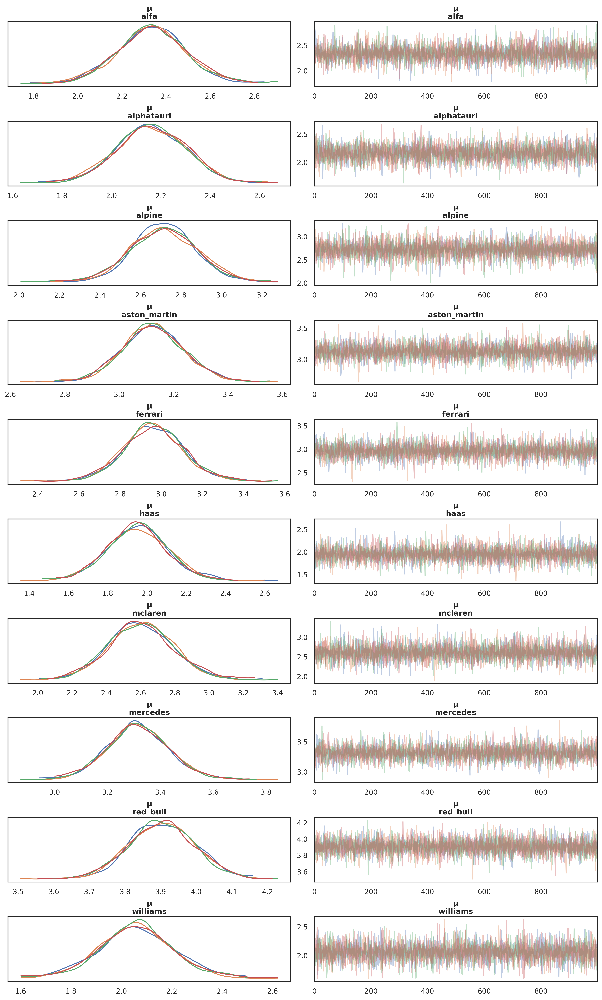

In [ ]:
#| label: fig-constructors-traceplots
#| fig-cap: "Traceplots of the μ parameter for the zero-inflated model when fitted to the constructors data"

az.plot_trace(const_idata, var_names=["μ"], compact=False);

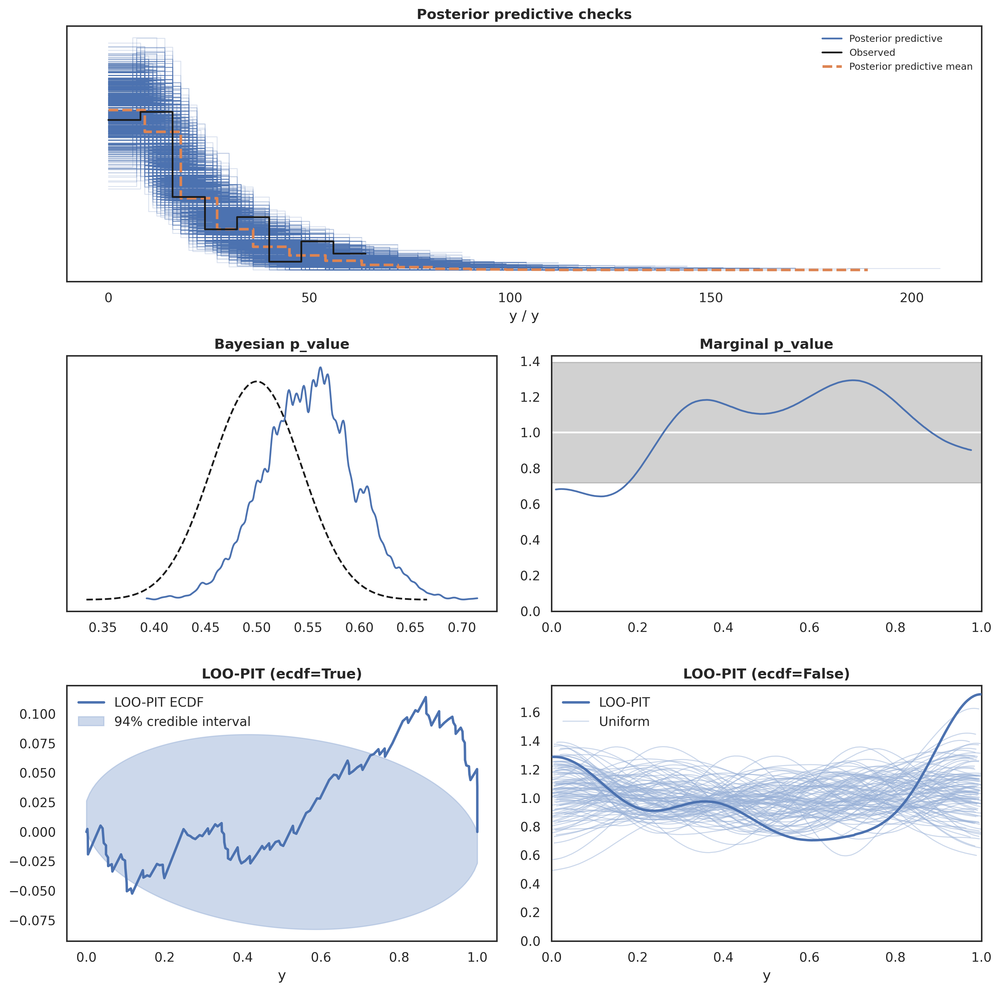

In [ ]:
#| label: fig-constructors-ppc
#| fig-cap: "Posterior predictive checks, p/u-value, and LOO for the zero-inflated model when fitted to the constructors data"

plot_posterior_predictive_checks(const_idata);

In [ ]:
az.loo(const_idata)

Computed from 4000 posterior samples and 130 observations log-likelihood matrix.

         Estimate       SE
elpd_loo  -439.55     9.30
p_loo       11.80        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)      130  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

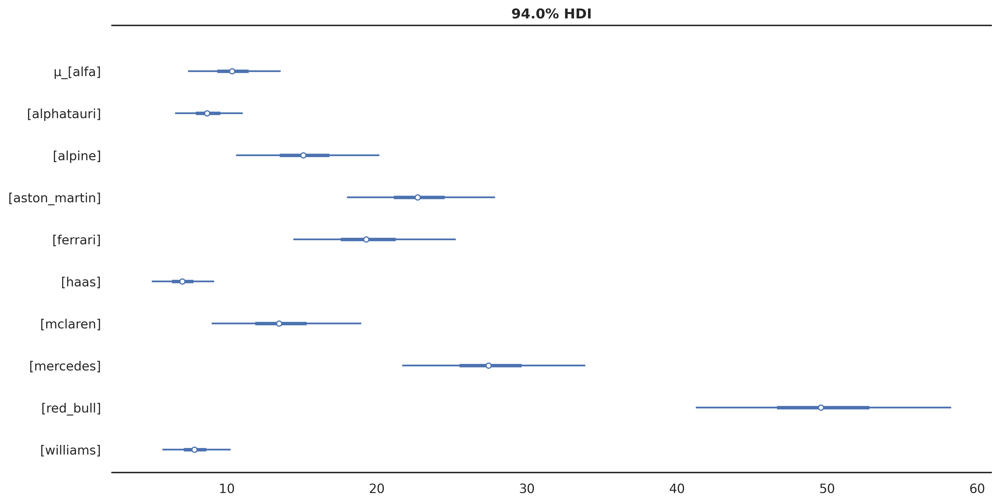

In [ ]:
#| label: fig-constructors-forest-mu
#| fig-cap: "Forest of the posterior distribution of the μ parameter for the zero-inflated model when fitted to the constructors data"
az.plot_forest(const_idata, var_names=["μ_"], combined=True, figsize=(12, 6));

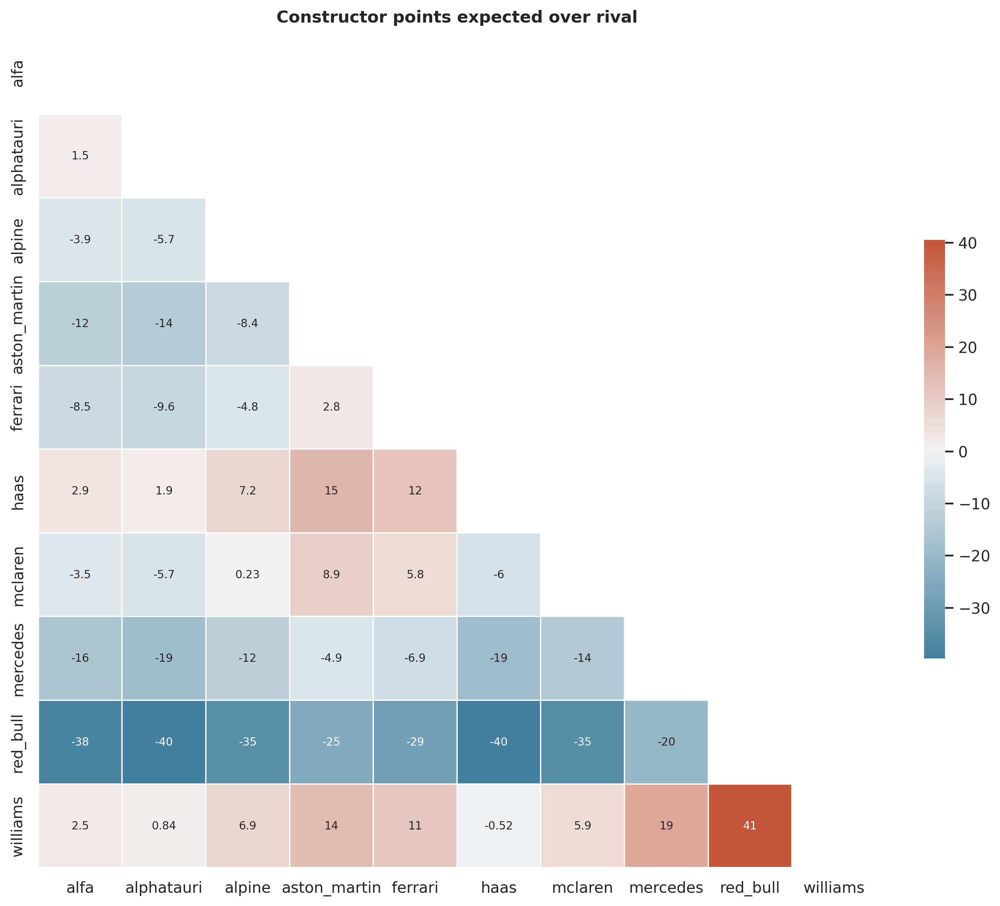

In [ ]:
#| code-fold: true
#| label: fig-constructors-comparison
#| fig-cap: "Expected points earned by constructor x over constructor y using the zero-inflated model"

sns.set_theme(style="white")

cmap = sns.diverging_palette(230, 20, as_cmap=True)

f, ax = plt.subplots(figsize=(11, 9))

comparison_df, mask = make_comparison(const_idata, const_idx, const_labels)

ax = sns.heatmap(
    comparison_df,
    cmap=cmap,
    mask=mask,
    annot=True,
    center=0,
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
    annot_kws={"fontsize": 8},
).set(title="Constructor points expected over rival");

## Conclusion

None of the results here are that surprising, but it's nonetheless useful to confirm our intuition for who's a good pick and who isn't. That said, the estimates should be taken with more than a grain of salt - the model we used is quite rudimentary (for one, it doesn't account for performance trends as the season progresses), and modeling the summed fantasy points directly leads to a lot of detail getting obscured and left out.

In [ ]:
%load_ext watermark
%watermark -n -u -v -iv

Last updated: Tue Sep 05 2023

Python implementation: CPython
Python version       : 3.11.4
IPython version      : 8.14.0

arviz     : 0.16.1
preliz    : 0.3.2
scipy     : 1.10.1
tqdm      : 4.66.1
matplotlib: 3.7.2
sys       : 3.11.4 (main, Jun 28 2023, 19:51:46) [GCC]
requests  : 2.31.0
pandas    : 2.1.0
pymc      : 5.7.2
numpy     : 1.25.2
json      : 2.0.9
seaborn   : 0.12.2



In [ ]:
#| echo: false
def gamma_exp_decay(t, λ):
    γ = np.exp(np.log(0.5) / λ)
    return γ ** (np.max(t) - t)